In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rcParams

import sklearn
from sklearn import metrics 
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler,StandardScaler
from sklearn.compose import make_column_transformer, make_column_selector
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.metrics import confusion_matrix, average_precision_score, recall_score

from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.tree import ExtraTreeClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm.classes import OneClassSVM
from sklearn.neural_network.multilayer_perceptron import MLPClassifier
from sklearn.neighbors.classification import RadiusNeighborsClassifier
from sklearn.neighbors.classification import KNeighborsClassifier
from sklearn.multioutput import ClassifierChain
from sklearn.multioutput import MultiOutputClassifier
from sklearn.multiclass import OutputCodeClassifier
from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from sklearn.linear_model.stochastic_gradient import SGDClassifier
from sklearn.linear_model.ridge import RidgeClassifierCV
from sklearn.linear_model.ridge import RidgeClassifier
from sklearn.linear_model.passive_aggressive import PassiveAggressiveClassifier    
from sklearn.gaussian_process.gpc import GaussianProcessClassifier
from sklearn.ensemble.weight_boosting import AdaBoostClassifier
from sklearn.ensemble.gradient_boosting import GradientBoostingClassifier
from sklearn.ensemble.bagging import BaggingClassifier
from sklearn.ensemble.forest import ExtraTreesClassifier
from sklearn.ensemble.forest import RandomForestClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.calibration import CalibratedClassifierCV
from sklearn.naive_bayes import GaussianNB
from sklearn.semi_supervised import LabelPropagation
from sklearn.semi_supervised import LabelSpreading
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import LinearSVC
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV
from sklearn.naive_bayes import MultinomialNB  
from sklearn.neighbors import NearestCentroid
from sklearn.svm import NuSVC
from sklearn.linear_model import Perceptron
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.svm import SVC

from imblearn.over_sampling import SMOTE

from imblearn.pipeline import Pipeline
from sklearn.neural_network import MLPClassifier


In [2]:
movie_industry = pd.read_csv(r'/Users/hojinlee/Documents/Columbia/2020/Fall2020/Datathon/Data/movie_industry.csv', encoding='latin-1')
oscar_df = pd.read_csv(r'/Users/hojinlee/Documents/Columbia/2020/Fall2020/Datathon/Data/the_oscar_award.csv')
genome_tag_df = pd.read_csv(r'/Users/hojinlee/Documents/Columbia/2020/Fall2020/Datathon/Data/movie_lense/genome-tags.csv')
genome_scores_df = pd.read_csv(r'/Users/hojinlee/Documents/Columbia/2020/Fall2020/Datathon/Data/movie_lense/genome-scores.csv')


In [169]:
movie_industry.head()

,budget,company,country,director,genre,gross,name,rating,released,runtime,score,star,votes,writer,year
0,8000000.0,Columbia Pictures Corporation,USA,Rob Reiner,Adventure,52287414.0,Stand by Me,R,1986-08-22,89,8.1,Wil Wheaton,299174,Stephen King,1986
1,6000000.0,Paramount Pictures,USA,John Hughes,Comedy,70136369.0,Ferris Bueller's Day Off,PG-13,1986-06-11,103,7.8,Matthew Broderick,264740,John Hughes,1986
2,15000000.0,Paramount Pictures,USA,Tony Scott,Action,179800601.0,Top Gun,PG,1986-05-16,110,6.9,Tom Cruise,236909,Jim Cash,1986
3,18500000.0,Twentieth Century Fox Film Corporation,USA,James Cameron,Action,85160248.0,Aliens,R,1986-07-18,137,8.4,Sigourney Weaver,540152,James Cameron,1986
4,9000000.0,Walt Disney Pictures,USA,Randal Kleiser,Adventure,18564613.0,Flight of the Navigator,PG,1986-08-01,90,6.9,Joey Cramer,36636,Mark H. Baker,1986


In [77]:
movies_df = pd.read_csv(r'/Users/hojinlee/Documents/Columbia/2020/Fall2020/Datathon/Data/movie_lense/movies.csv')
movies_df['year'] = movies_df['title'].map(lambda x: str(x)[-5:-1])
movies_df['title'] = movies_df['title'].map(lambda x: str(x)[:-7])
movies_df = movies_df[movies_df.year.apply(lambda x: x.isnumeric())]
movies_df['year'] = movies_df['year'].astype(int)
movies_df.head()

,movieId,title,genres,year,freq_0,freq_1,freq_2
0,61,Eye for an Eye,Drama|Thriller,1996,0.282391,0.396442,0.321168
1,63,Don't Be a Menace to South Central While Drink...,Comedy|Crime,1996,0.282391,0.396442,0.321168
2,64,Two if by Sea,Comedy|Romance,1996,0.282391,0.396442,0.321168
3,65,Bio-Dome,Comedy,1996,0.282391,0.396442,0.321168
4,66,Lawnmower Man 2: Beyond Cyberspace,Action|Sci-Fi|Thriller,1996,0.282391,0.396442,0.321168


In [4]:
genome_scores_df['rank'] = genome_scores_df.groupby('movieId')['relevance'].rank(ascending=False, method='first')
genome_scores_df.sort_values(by='rank', ascending=True)
genome_scores_df_top50 = genome_scores_df[genome_scores_df['rank'] < 50]
genome_scores_df_top50 = genome_scores_df_top50.merge(movies_df[['movieId','title']], on='movieId',how='inner')
genome_scores_df_top50 = genome_scores_df_top50.merge(genome_tag_df)
genome_scores_df_top50 = pd.pivot_table(genome_scores_df_top50[['title', 'tag','relevance']],values=['relevance'], columns=["tag"], index=['title']).fillna(0)
genome_scores_df_top50.columns = genome_scores_df_top50.columns.droplevel(0)
genome_scores_df_top50 = genome_scores_df_top50.reset_index()


In [249]:
genome_scores_df_top50[genome_scores_df_top50['title'] =='Toy Story'].T.reset_index().to_csv('toystory.csv')

In [155]:
oscar_nominated_film = oscar_df.film.unique().tolist()
print('The number of movies that won oscar: ', len(oscar_nominated_film))
print('The number of movies that were in movie lens data was: ', len(movies_df[movies_df['title'].isin(oscar_nominated_film)]))

movielens_oscar_data = movies_df[movies_df['title'].isin(oscar_nominated_film)]
movielens_oscar_data.head()

The number of movies that won oscar:  4834
The number of movies that were in movie lens data was:  1266


,movieId,title,genres,year,freq_0,freq_1,freq_2
11,88,Black Sheep,Comedy,1996,0.282391,0.396442,0.321168
14,95,Broken Arrow,Action|Adventure|Thriller,1996,0.282391,0.396442,0.321168
28,140,Up Close and Personal,Drama|Romance,1996,0.282391,0.396442,0.321168
34,605,One Fine Day,Drama|Romance,1996,0.282391,0.396442,0.321168
35,608,Fargo,Comedy|Crime|Drama|Thriller,1996,0.282391,0.396442,0.321168


In [250]:
oscar_unique = oscar_df[['ceremony','film']].drop_duplicates()
oscar_unique['nominated'] = 1 
print(len(oscar_unique))
merged = movie_industry.merge(oscar_unique, left_on='name', right_on ='film', how='left')
merged['nominated'] = merged['nominated'].fillna(0)
merged = merged[merged['country']=='USA'].reset_index()
merged.drop(['ceremony','index'], axis=1, inplace=True)
merged['year'] = merged['year'].astype(int)

label = pd.read_csv(r'count_label.csv')
label = label.rename(columns={"Unnamed: 0": "year"})
label.drop(['count_0','count_1','count_2'], axis=1,inplace=True)
merged = merged.merge(label, on='year', how='left')

merged = merged.merge(genome_scores_df_top50, left_on='name', right_on='title', how='left')
merged = merged[merged['title'].notna()]
print(len(merged))
merged.head()

5024
3497


,budget,company,country,director,genre,gross,name,rating,released,runtime,...,world politics,world war i,world war ii,writer's life,writers,writing,wuxia,wwii,zombie,zombies
0,8000000.0,Columbia Pictures Corporation,USA,Rob Reiner,Adventure,52287414.0,Stand by Me,R,1986-08-22,89,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,6000000.0,Paramount Pictures,USA,John Hughes,Comedy,70136369.0,Ferris Bueller's Day Off,PG-13,1986-06-11,103,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,15000000.0,Paramount Pictures,USA,Tony Scott,Action,179800601.0,Top Gun,PG,1986-05-16,110,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,18500000.0,Twentieth Century Fox Film Corporation,USA,James Cameron,Action,85160248.0,Aliens,R,1986-07-18,137,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,9000000.0,Walt Disney Pictures,USA,Randal Kleiser,Adventure,18564613.0,Flight of the Navigator,PG,1986-08-01,90,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [251]:
X = merged.loc[:, merged.columns != 'nominated'] 
y = merged['nominated']

X.drop(['company','country', 'director','name', 'released', 'star', 'writer', 'year','film','title'], axis=1, inplace=True)
#X = X[['company','genre', 'rating','votes','score', 'budget', 'gross',]]
avg_pl_conversion = merged[merged['budget']!=0]['gross'].mean() / merged[merged['budget']!=0]['budget'].mean()
X.loc[X.budget == 0, 'budget'] = X[X.budget == 0]['gross']/ avg_pl_conversion
#X.drop(['score','budget', 'gross'], axis=1, inplace=True)
X['ROI'] = X['gross'] / X['budget']
X.drop(['oscar','oscar (best actor)','oscar (best actress)','oscar (best animated feature)'
        ,'oscar (best cinematography)','oscar (best directing)','oscar (best editing)'
        ,'oscar (best effects - visual effects)','oscar (best foreign language film)'
        ,'oscar (best music - original score)','oscar (best music - original song)'
        ,'oscar (best picture)','oscar (best sound)','oscar (best supporting actor)'
        ,'oscar (best supporting actress)','oscar (best writing - screenplay written directly for the screen)'
        ,'oscar winner'], axis=1, inplace=True)

X.head()

/Users/hojinlee/opt/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:4117: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
/Users/hojinlee/opt/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s
/Users/hojinlee/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: htt

,budget,genre,gross,rating,runtime,score,votes,freq_0,freq_1,freq_2,...,world war i,world war ii,writer's life,writers,writing,wuxia,wwii,zombie,zombies,ROI
0,8000000.0,Adventure,52287414.0,R,89,8.1,299174,0.33,0.33,0.33,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.535927
1,6000000.0,Comedy,70136369.0,PG-13,103,7.8,264740,0.33,0.33,0.33,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,11.689395
2,15000000.0,Action,179800601.0,PG,110,6.9,236909,0.33,0.33,0.33,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,11.986707
3,18500000.0,Action,85160248.0,R,137,8.4,540152,0.33,0.33,0.33,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.603257
4,9000000.0,Adventure,18564613.0,PG,90,6.9,36636,0.33,0.33,0.33,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.062735


In [252]:
categorical = X.dtypes == object
#numeric_features = X.columns[~categorical].tolist()
X = pd.get_dummies(X, prefix=X.columns[categorical].tolist())
X.head()


,budget,gross,runtime,score,votes,freq_0,freq_1,freq_2,007,007 (series),...,genre_Romance,genre_Sci-Fi,genre_Thriller,rating_G,rating_NC-17,rating_NOT RATED,rating_PG,rating_PG-13,rating_R,rating_UNRATED
0,8000000.0,52287414.0,89,8.1,299174,0.33,0.33,0.33,0.0,0.0,...,0,0,0,0,0,0,0,0,1,0
1,6000000.0,70136369.0,103,7.8,264740,0.33,0.33,0.33,0.0,0.0,...,0,0,0,0,0,0,0,1,0,0
2,15000000.0,179800601.0,110,6.9,236909,0.33,0.33,0.33,0.0,0.0,...,0,0,0,0,0,0,1,0,0,0
3,18500000.0,85160248.0,137,8.4,540152,0.33,0.33,0.33,0.0,0.0,...,0,0,0,0,0,0,0,0,1,0
4,9000000.0,18564613.0,90,6.9,36636,0.33,0.33,0.33,0.0,0.0,...,0,0,0,0,0,0,1,0,0,0


In [253]:
minmax_scaler = MinMaxScaler()
std_scaler = StandardScaler()

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
#'votes', 'budget', 'gross'
X_train[['votes', 'budget', 'gross']] = minmax_scaler.fit_transform(X_train[['votes', 'budget', 'gross']])
X_test[['votes', 'budget', 'gross']] = minmax_scaler.transform(X_test[['votes', 'budget', 'gross']])
#'score','ROI'
X_train[['ROI']] = std_scaler.fit_transform(X_train[['ROI']])
X_test[['ROI']] = std_scaler.transform(X_test[['ROI']])

print("Number transactions X_train dataset: ", X_train.shape)
print("Number transactions y_train dataset: ", y_train.shape)
print("Number transactions X_test dataset: ", X_test.shape)
print("Number transactions y_test dataset: ", y_test.shape)

print("Before OverSampling, counts of label '1': {}".format(sum(y_train==1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train==0)))

sm = SMOTE(random_state=2)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train.ravel())

print('After OverSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train_res.shape))
print("After OverSampling, counts of label '1': {}".format(sum(y_train_res==1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train_res==0)))

/Users/hojinlee/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/Users/hojinlee/opt/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s
/Users/hojinlee/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



Number transactions X_train dataset:  (2797, 1141)
Number transactions y_train dataset:  (2797,)
Number transactions X_test dataset:  (700, 1141)
Number transactions y_test dataset:  (700,)
Before OverSampling, counts of label '1': 485
Before OverSampling, counts of label '0': 2312 

After OverSampling, the shape of train_X: (4624, 1141)
After OverSampling, the shape of train_y: (4624,) 

After OverSampling, counts of label '1': 2312
After OverSampling, counts of label '0': 2312


In [261]:
while average_precision < 0.485:
    print('---------------------')
    print('random_forest')
    clf = random_forest
    print(cross_val_score(clf, X_train_res,y_train_res, cv=3))
    clf.fit(X_train_res,y_train_res)
    print("model score: %.3f" % clf.score(X_test, y_test))
    y_pred = clf.predict(X_test)
    print(confusion_matrix(y_test, y_pred))
    average_precision = average_precision_score(y_test, y_pred)
    #recall_score = recall_score(y_test, y_pred, average='macro')
    print('average_precision', average_precision)
    #print('recall_score', recall_score)

---------------------
random_forest
[0.90337224 0.96625568 0.95976639]
model score: 0.891
[[558  29]
 [ 47  66]]
average_precision 0.4729183578415065
---------------------
random_forest
[0.90726329 0.96625568 0.96171317]
model score: 0.887
[[559  28]
 [ 51  62]]
average_precision 0.4508315774687456
---------------------
random_forest
[0.89883268 0.96625568 0.95327709]
model score: 0.897
[[564  23]
 [ 49  64]]
average_precision 0.48664123690367206


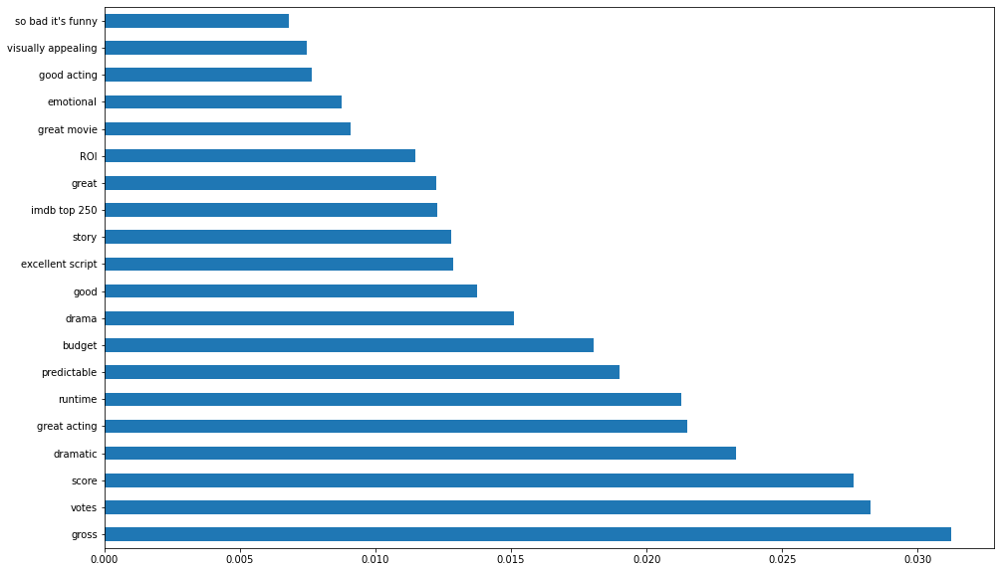

In [265]:
plt.figure(figsize=(16, 10))

feat_importances = pd.Series(clf.feature_importances_, index=X_train_res.columns)
feat_importances.nlargest(20).plot(kind='barh')

plt.savefig('top_features.jpg', bbox_inches='tight', dpi=500)


In [97]:
logistic_regression = LogisticRegression()
random_forest = RandomForestClassifier()
LDA = LinearDiscriminantAnalysis()
KNN = KNeighborsClassifier()
naive_bayes = GaussianNB()
tree = DecisionTreeClassifier()
svm = SVC()
svm_linear = SVC(kernel='linear')
svm_poly = SVC(kernel='poly')
nn = MLPClassifier(solver='adam', activation='relu', alpha=1e-5, hidden_layer_sizes=(8,8,8), random_state=1, max_iter=500)
ExtraTreeClassifiers = ExtraTreeClassifier()
SGDClassifiers = SGDClassifier()
GradientBoostingClassifiers = GradientBoostingClassifier()
AdaBoostClassifiers= AdaBoostClassifier()
ExtraTreesClassifiers = ExtraTreesClassifier()
NearestCentroids = NearestCentroid()


In [104]:
classifiers = [logistic_regression, random_forest, LDA, KNN, naive_bayes, tree, svm, svm_linear, svm_poly, nn, ExtraTreeClassifiers, SGDClassifiers, GradientBoostingClassifiers, AdaBoostClassifiers, ExtraTreesClassifiers, NearestCentroids]
classifier_names = ['logistic_regression', 'random_forest', 'LDA', 'KNN', 'naive_bayes', 'tree', 'svm', 'svm_linear', 'svm_poly', 'neural_net', 'ExtraTreeClassifier', 'SGDClassifier', 'GradientBoostingClassifier', 'AdaBoostClassifier', 'ExtraTreesClassifier', 'NearestCentroid']

for clf, name in zip(classifiers, classifier_names):
    print('---------------------')
    print(name)
    print(cross_val_score(clf, X_train_res,y_train_res, cv=3))
    clf.fit(X_train_res,y_train_res)
    print("model score: %.3f" % clf.score(X_test, y_test))
    y_pred = clf.predict(X_test)
    print(confusion_matrix(y_test, y_pred))
    average_precision = average_precision_score(y_test, y_pred)
    #recall_score = recall_score(y_test, y_pred, average='macro')
    print('average_precision', average_precision)
    #print('recall_score', recall_score)
    

---------------------
ExtraTreeClassifier
[0.81124758 0.85585003 0.84346701]
model score: 0.790
[[483  96]
 [ 51  70]]
average_precision 0.31680815351132985
---------------------
SGDClassifier
[0.5727214  0.88687783 0.75032342]
model score: 0.859
[[518  61]
 [ 38  83]]
average_precision 0.44965991079627443
---------------------
GradientBoostingClassifier
[0.83128636 0.93988365 0.95407503]
model score: 0.883
[[537  42]
 [ 40  81]]
average_precision 0.4979813977596683
---------------------
AdaBoostClassifier
[0.80090498 0.92436975 0.92302717]
model score: 0.854
[[523  56]
 [ 46  75]]
average_precision 0.4205814865218057
---------------------
ExtraTreesClassifier
[0.93859082 0.95669037 0.96571798]
model score: 0.886
[[554  25]
 [ 55  66]]
average_precision 0.47417582417582416
---------------------
NearestCentroid
[0.69036846 0.69941823 0.66623545]
model score: 0.750
[[451 128]
 [ 47  74]]
average_precision 0.2911834430196266


In [102]:
import xgboost as xgb
clf=xgb.XGBClassifier(random_state=1,learning_rate=0.01)

print('---------------------')
print('XGB')
print(cross_val_score(clf, X_train_res,y_train_res, cv=3))
clf.fit(X_train_res,y_train_res)
print("model score: %.3f" % clf.score(X_test, y_test))
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
average_precision = average_precision_score(y_test, y_pred)
#recall_score = recall_score(y_test, y_pred, average='macro')
print('average_precision', average_precision)
#print('recall_score', recall_score)

---------------------
XGB
[0.82094376 0.8487395  0.87451488]
model score: 0.827
[[487  92]
 [ 29  92]]
average_precision 0.4215938606847698


In [133]:
estimator = clf.estimators_[5]
import os
from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X_train.columns,
                class_names = ['True', 'False'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])
#os.system('dot -Tpng tree.dot -o tree.png')

0

In [34]:

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

In [101]:
classifiers = [logistic_regression, random_forest, LDA, KNN, naive_bayes, tree, svm, svm_linear, svm_poly, nn]
classifier_names = ['logistic_regression', 'random_forest', 'LDA', 'KNN', 'naive_bayes', 'tree', 'svm', 'svm_linear', 'svm_poly', 'neural_net']

# classifiers = [logistic_regression,svm_linear, svm_poly, nn]
# classifier_names = ['logistic_regression', 'svm_linear', 'svm_poly', 'neural_net']


for clf, name in zip(classifiers, classifier_names):
    print('---------------------')
    print(name)
    print(cross_val_score(clf, X_train_res,y_train_res, cv=3))
    clf.fit(X_train_res,y_train_res)
    print("model score: %.3f" % clf.score(X_test, y_test))
    y_pred = clf.predict(X_test)
    print(confusion_matrix(y_test, y_pred))
    average_precision = average_precision_score(y_test, y_pred)
    #recall_score = recall_score(y_test, y_pred, average='macro')
    print('average_precision', average_precision)
    #print('recall_score', recall_score)

---------------------
logistic_regression


/Users/hojinlee/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
/Users/hojinlee/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/

[0.8487395  0.9321267  0.92884864]


/Users/hojinlee/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


model score: 0.869
[[529  50]
 [ 42  79]]
average_precision 0.4598334294317381
---------------------
random_forest
[0.90174531 0.95927602 0.96442432]
model score: 0.891
[[551  28]
 [ 48  73]]
average_precision 0.5046241247501373
---------------------
LDA
[0.67420814 0.83516484 0.8389392 ]
model score: 0.761
[[460 119]
 [ 48  73]]
average_precision 0.29795331562377014
---------------------
KNN
[0.73884939 0.77310924 0.78007762]
model score: 0.621
[[330 249]
 [ 16 105]]
average_precision 0.28024613291177236
---------------------
naive_bayes
[0.67485456 0.68648998 0.66688228]
model score: 0.447
[[218 361]
 [ 26  95]]
average_precision 0.2007103502558048
---------------------
tree
[0.81577246 0.90303814 0.89586028]
model score: 0.817
[[509  70]
 [ 58  63]]
average_precision 0.32948611197415023
---------------------
svm
[0.72592114 0.72010343 0.69146184]
model score: 0.779
[[461 118]
 [ 37  84]]
average_precision 0.34154055665306793
---------------------
svm_linear
[0.83128636 0.93148028 0.

In [ ]:
for x,y,z in zip(merged.iloc[X_test.index.tolist()]['name'].values,y_test,clf.predict(X_test)):
    if y ==1 or z ==1:
        print(x,y,z)

## Predicting oscar out of nominees

In [ ]:
movie_industry = pd.read_csv(r'/Users/hojinlee/Documents/Columbia/2020/Fall2020/Datathon/Data/movie_industry.csv', encoding='latin-1')
oscar_df = pd.read_csv(r'/Users/hojinlee/Documents/Columbia/2020/Fall2020/Datathon/Data/the_oscar_award.csv')


In [ ]:
movie_industry.head()

In [ ]:
oscar_df.head()

In [ ]:
oscar_unique = oscar_df[['ceremony','film','winner']].drop_duplicates()
print(len(oscar_unique))
merged = oscar_unique.merge(movie_industry, left_on='name', right_on ='film', how='left')
merged['nominated'] = merged['nominated'].fillna(0)
merged = merged[merged['country']=='USA'].reset_index()
merged.drop(['ceremony','index'], axis=1, inplace=True)
print(len(merged))

In [ ]:
genome_tag_df.head()